EJERCICIO 1:

In [ ]:
!pip show geopandas

Name: geopandas
Version: 1.0.1
Summary: Geographic pandas extensions
Home-page: 
Author: 
Author-email: Kelsey Jordahl <kjordahl@alum.mit.edu>
License: BSD 3-Clause
Location: /usr/local/lib/python3.10/dist-packages
Requires: numpy, packaging, pandas, pyogrio, pyproj, shapely
Required-by: bigframes


In [ ]:
#Map Projection and Reprojecting
import os, geopandas as gpd

countries=gpd.read_file(os.path.join("https://github.com/Halabbi/introgeodf/raw/refs/heads/main/MAPAS/World_Countries/World_Countries.shp"))
cities=gpd.read_file(os.path.join("https://github.com/Halabbi/introgeodf/raw/refs/heads/main/MAPAS/World_Cities/World_Cities.shp"))
rivers=gpd.read_file(os.path.join("https://github.com/Halabbi/introgeodf/raw/refs/heads/main/MAPAS/World_Hydrography/World_Hydrography.shp"))

In [ ]:
rusia=countries[countries.COUNTRY=='Russia']
rusia

,COUNTRY,geometry
188,Russia,"MULTIPOLYGON (((58.06138 81.68776, 57.98055 81..."


In [ ]:
#información del CRS de Rusia
rusia.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [ ]:
#comprobar las unidades de medida
rusia.crs.axis_info

[Axis(name=Geodetic latitude, abbrev=Lat, direction=north, unit_auth_code=EPSG, unit_code=9122, unit_name=degree),
 Axis(name=Geodetic longitude, abbrev=Lon, direction=east, unit_auth_code=EPSG, unit_code=9122, unit_name=degree)]

In [ ]:
# comprobar si está proyectado o no
rusia.crs.is_projected

False

In [ ]:
#Centroide no proyectado
rusia.centroid

<ipython-input-7-a34fc6eb7240>:2: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  rusia.centroid


,0
188,POINT (96.69193 61.98838)


In [ ]:
rusia.to_crs(6078).crs.axis_info

[Axis(name=Easting, abbrev=E, direction=east, unit_auth_code=EPSG, unit_code=9001, unit_name=metre),
 Axis(name=Northing, abbrev=N, direction=north, unit_auth_code=EPSG, unit_code=9001, unit_name=metre)]

In [ ]:
# Está proyectado
rusia.to_crs(6078).centroid

,0
188,POINT (16052701.159 2148267.303)


<Axes: >

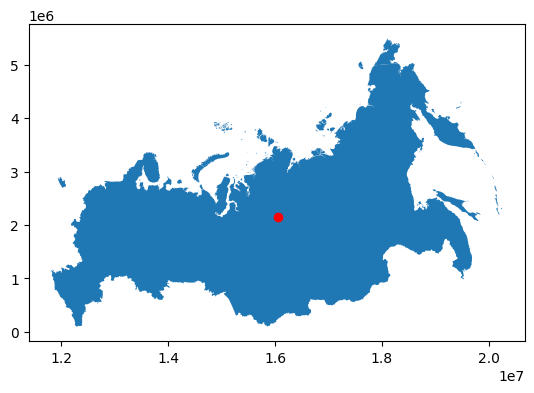

In [ ]:
base6078=rusia.to_crs(6078).plot()
rusia.to_crs(6078).centroid.plot(color='red',ax=base6078)

<Axes: >

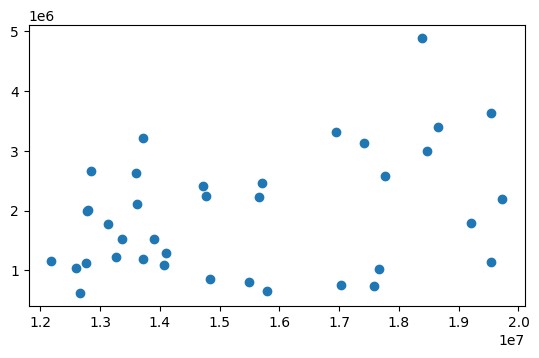

In [ ]:
cities_Russia_6078=cities[cities.COUNTRY=='Russia'].to_crs(6078)
cities_Russia_6078.plot()

<Axes: >

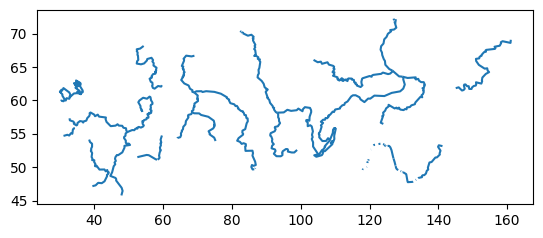

In [ ]:
rivers_Russia_clipped=gpd.clip(rivers,rusia)
rivers_Russia_clipped.plot()

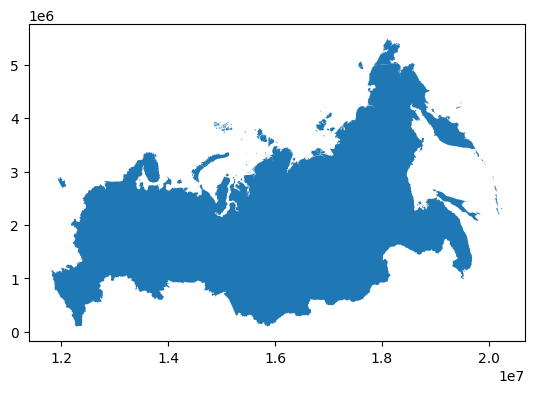

In [ ]:
rusia_6078=rusia.to_crs(6078)
rusia_6078.plot()

rivers_Russia_6078=rivers_Russia_clipped.to_crs(rusia_6078.crs)

In [ ]:
import os
rusia.to_file(os.path.join("MAPAS","rusiaMAPAS_6078.gpkg"), layer='country', driver="GPKG")
cities_Russia_6078.to_file(os.path.join("MAPAS","rusiaMAPAS_6078.gpkg"), layer='cities', driver="GPKG")
rivers_Russia_6078.to_file(os.path.join("MAPAS","rusiaMAPAS_6078.gpkg"), layer='rivers', driver="GPKG")

EJERCICIO 2:

In [ ]:
#Creating Spatial data
import pandas as pd
infoairports=pd.read_csv(os.path.join("data","russia_airports.csv"))

# some rows

infoairports.iloc[[0,1,2,3,-4,-3,-2,-1],:] #head and tail

,id,ident,type,name,latitude_deg,longitude_deg,elevation_ft,continent,iso_country,iso_region,municipality,scheduled_service,gps_code,iata_code,local_code,home_link,wikipedia_link,keywords
0,330380,DHG,small_airport,Dalnegorsk Airport,44.558748,135.490005,833.0,EU,RU,RU-PRI,Dalnegorsk,no,NaN,DHG,NaN,NaN,NaN,NaN
1,330383,DLR,small_airport,Dalnerechensk Airport,45.877949,133.735822,272.0,EU,RU,RU-PRI,Dalnerechensk,yes,UHHD,DLR,NaN,NaN,NaN,NaN
2,315624,DPT,small_airport,Deputatskiy Airport,69.392503,139.890012,950.0,EU,RU,RU-SA,Deputatskiy,yes,UEBD,DPT,NaN,NaN,https://en.wikipedia.org/wiki/Deputatsky_Airport,"УЕБД, Deputatsky Airport, Аэропорт Депутатский..."
3,34933,RU-0001,medium_airport,Levashovo Air Base,60.086700,30.193300,60.0,EU,RU,RU-SPE,St. Petersburg,no,NaN,NaN,NaN,NaN,https://en.wikipedia.org/wiki/Levashovo_%28air...,"Levashevo, Leningrad, Petrograd"
1680,44992,XUBS,medium_airport,Smolensk North Airport,54.824000,32.025000,820.0,EU,RU,RU-SMO,Smolensk,no,NaN,LNX,XUBS,NaN,https://en.wikipedia.org/wiki/Smolensk_North_A...,"Smolensk Severny Airfield, Аэродром Смоленск С..."
1681,44765,XWPD,small_airport,Sosnovka Airfield,53.261002,45.277000,NaN,EU,RU,RU-PNZ,Penza,no,NaN,NaN,XWPD,NaN,NaN,"Chemodanovka Airfield, Аэродром Сосновка, Аэро..."
1682,35064,XWPR,medium_airport,Rtishchevo Air Base,52.297317,43.724100,673.0,EU,RU,RU-SAR,Rtishchevo,no,NaN,NaN,XWPR,NaN,https://en.wikipedia.org/wiki/Rtishchevo_(air_...,"ЬВПР, Ртищево"
1683,542653,ZB35,closed,Sudzha Airfield,51.212486,35.347897,635.0,EU,RU,RU-KRS,Sudzha,no,NaN,NaN,NaN,NaN,NaN,"ZB35, ЗБ35, Су́джа"


In [ ]:
# keep the  columns needed

infoairports.columns

Index(['id', 'ident', 'type', 'name', 'latitude_deg', 'longitude_deg',
       'elevation_ft', 'continent', 'iso_country', 'iso_region',
       'municipality', 'scheduled_service', 'gps_code', 'iata_code',
       'local_code', 'home_link', 'wikipedia_link', 'keywords'],
      dtype='object')

In [ ]:
keep=['name','type','latitude_deg', 'longitude_deg','elevation_ft','iso_region','municipality']
infoairports=infoairports.loc[:,keep]

infoairports.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1684 entries, 0 to 1683
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   name           1684 non-null   object 
 1   type           1684 non-null   object 
 2   latitude_deg   1684 non-null   float64
 3   longitude_deg  1684 non-null   float64
 4   elevation_ft   1067 non-null   float64
 5   iso_region     1684 non-null   object 
 6   municipality   1568 non-null   object 
dtypes: float64(3), object(4)
memory usage: 92.2+ KB


In [ ]:
numericCols=['latitude_deg', 'longitude_deg','elevation_ft']
infoairports[numericCols]=infoairports.loc[:,numericCols].apply(lambda x:pd.to_numeric(x))

In [ ]:
# now
infoairports.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1684 entries, 0 to 1683
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   name           1684 non-null   object 
 1   type           1684 non-null   object 
 2   latitude_deg   1684 non-null   float64
 3   longitude_deg  1684 non-null   float64
 4   elevation_ft   1067 non-null   float64
 5   iso_region     1684 non-null   object 
 6   municipality   1568 non-null   object 
dtypes: float64(3), object(4)
memory usage: 92.2+ KB


<Axes: xlabel='longitude_deg', ylabel='latitude_deg'>

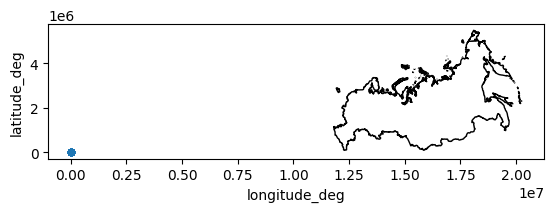

In [ ]:
# let's plot

base = rusia_6078.plot(color='white', edgecolor='black') #unprojected

infoairports.plot.scatter(x= 'longitude_deg', y= 'latitude_deg',ax=base)

<Axes: >

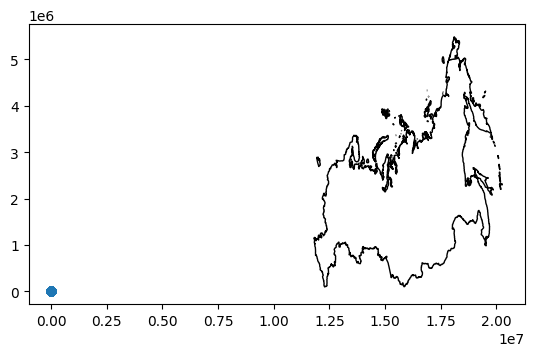

In [ ]:
airports=gpd.GeoDataFrame(data=infoairports.copy(),
                 geometry=gpd.points_from_xy(infoairports.longitude_deg,
                                             infoairports.latitude_deg),
                 crs=rusia.crs.to_epsg())# the coordinates were in degrees - unprojected

# let's plot

base = rusia_6078.plot(color='white', edgecolor='black')
airports.plot(ax=base)

In [ ]:
type(airports), type(infoairports)

(geopandas.geodataframe.GeoDataFrame, pandas.core.frame.DataFrame)

<Axes: >

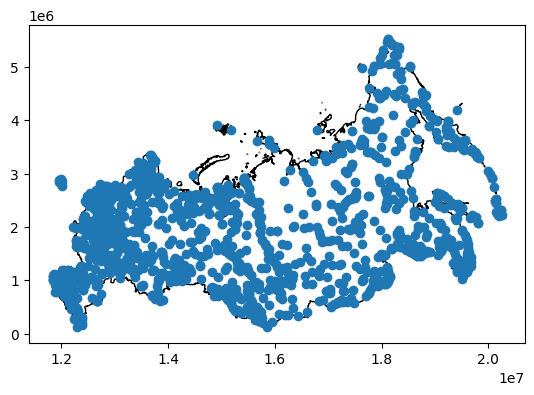

In [ ]:
airports_6078=airports.to_crs(6078)

## then

base = rusia_6078.plot(color='white', edgecolor='black')
airports_6078.plot(ax=base)

In [ ]:
airports_6078['type'].value_counts() # this will not work: airports.type.value_counts()

,count
type,
small_airport,645
heliport,474
closed,307
medium_airport,238
large_airport,16
seaplane_base,4


In [ ]:
airports_6078.rename(columns={'type':'kind'},inplace=True)

## adding the airports to GPKG
airports_6078.to_file(os.path.join("MAPAS","rusiaMAPAS_6078.gpkg"), layer='airports', driver="GPKG")

EJERCICIO 3:

In [ ]:
#Formating Geoseries projections
rusia_6078

,COUNTRY,geometry
188,Russia,"MULTIPOLYGON (((15109031.538 3917547.292, 1510..."


In [ ]:
rusia_6078.boundary

,0
188,"MULTILINESTRING ((15109031.538 3917547.292, 15..."


<Axes: >

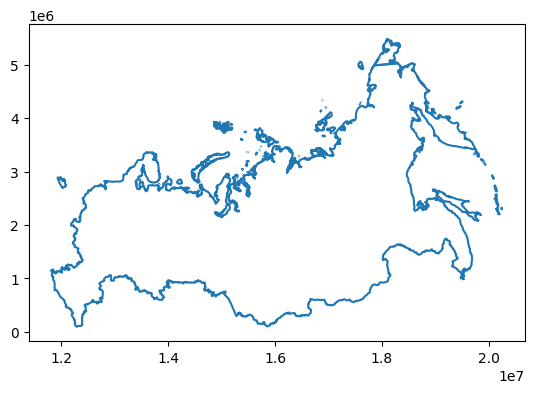

In [ ]:
rusia_6078.boundary.plot()

In [ ]:
# para ver si es un geodataframe
type(rusia_6078.boundary)

geopandas.geoseries.GeoSeries

In [ ]:
# convertir geoserie en geodataframe
rusia_6078.boundary.to_frame()
# va a mostrar informacion geometrica (columna cero)

,0
188,"MULTILINESTRING ((15109031.538 3917547.292, 15..."


In [ ]:
rusia_6078.boundary.to_frame().info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 1 entries, 188 to 188
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype   
---  ------  --------------  -----   
 0   0       1 non-null      geometry
dtypes: geometry(1)
memory usage: 16.0 bytes


In [ ]:
# conversion
rusia_border=rusia_6078.boundary.to_frame()

# nueva columna con nombre del pais
rusia_border['name']='Russia'

# columna cero que se llame geometry
rusia_border.rename(columns={0:'geometry'},inplace=True)

#que la columna geometry sea la columna de geometría, porque quieres que solo 1 sea geometría
#esto es por ejm si tenemos una proyectada y otra sin proyectar, para que escoja cuál será la geomtería
rusia_border = rusia_border.set_geometry("geometry")

# verifying:
rusia_border.crs

<Projected CRS: EPSG:6078>
Name: WGS 84 / EPSG Arctic zone 3-15
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: Arctic (Russia onshore and offshore) - between 81°10'N and 76°10'N, approximately 67°E to approximately 98°E. May be extended westwards or eastwards within the latitude limits.
- bounds: (67.0, 76.16, 98.01, 81.17)
Coordinate Operation:
- name: EPSG Arctic LCC zone 3-15
- method: Lambert Conic Conformal (2SP)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [ ]:
rusia_border

,geometry,name
188,"MULTILINESTRING ((15109031.538 3917547.292, 15...",Russia


EJERCICIO 4:

In [ ]:
#Maps Lacking CRS information
rusia_states=gpd.read_file("https://github.com/Halabbi/introgeodf/raw/refs/heads/main/MAPAS/rusia_subnational/rus_adm_gadm_2022_v03/rus_admbnda_adm1_gadm_2022_v02.shp")
rusia_municipalities=gpd.read_file("https://github.com/Halabbi/introgeodf/raw/refs/heads/main/MAPAS/rusia_subnational/rus_adm_gadm_2022_v03/rus_admbnda_adm2_gadm_2022_v02.shp")


In [ ]:
type(rusia_states),type(rusia_municipalities)

(geopandas.geodataframe.GeoDataFrame, geopandas.geodataframe.GeoDataFrame)

In [ ]:
rusia_states.geometry.head()

NameError: name 'rusia_states' is not defined

In [ ]:
rusia_municipalities.geometry.head()

,geometry
0,"POLYGON Z ((61.2976 56.3814 0, 61.3248 56.378 ..."
1,"POLYGON Z ((44.8928 43.5435 0, 44.9092 43.5332..."
2,"POLYGON Z ((39.6479 45.1642 0, 39.68 45.1556 0..."
3,"POLYGON Z ((54.8635 56.4575 0, 54.9626 56.4045..."
4,"POLYGON Z ((46.5841 48.6155 0, 46.5193 48.4976..."


In [ ]:
#Si tiene CRS
rusia_states.crs , rusia_municipalities.crs

(<Geographic 2D CRS: EPSG:4326>
 Name: WGS 84
 Axis Info [ellipsoidal]:
 - Lat[north]: Geodetic latitude (degree)
 - Lon[east]: Geodetic longitude (degree)
 Area of Use:
 - name: World.
 - bounds: (-180.0, -90.0, 180.0, 90.0)
 Datum: World Geodetic System 1984 ensemble
 - Ellipsoid: WGS 84
 - Prime Meridian: Greenwich,
 <Geographic 2D CRS: EPSG:4326>
 Name: WGS 84
 Axis Info [ellipsoidal]:
 - Lat[north]: Geodetic latitude (degree)
 - Lon[east]: Geodetic longitude (degree)
 Area of Use:
 - name: World.
 - bounds: (-180.0, -90.0, 180.0, 90.0)
 Datum: World Geodetic System 1984 ensemble
 - Ellipsoid: WGS 84
 - Prime Meridian: Greenwich)

<Axes: >

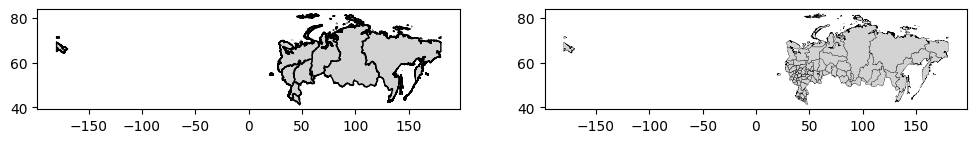

In [ ]:
import matplotlib.pyplot as plt

fig, (ax1, ax2) = plt.subplots(ncols=2, sharex=False, sharey=False, figsize=(12,12))

rusia_states.plot(ax=ax1, facecolor='lightgrey', edgecolor='black')
rusia_municipalities.plot(ax=ax2, facecolor='lightgrey', edgecolor='black',linewidth=0.2)


In [ ]:
#Comprobando que tiene CRS
rusia_states.to_crs(6078)

,iso3,ADM0_EN,ADM0_PCODE,ADM1_EN,ADM1_PCODE,UNHCR_code,geometry
0,RUS,Russian Federation,RU,Volga Federal District,RU008,20RUS008,"POLYGON Z ((14243143.731 1823103.884 0, 142384..."
1,RUS,Russian Federation,RU,Far Eastern Federal District,RU002,20RUS002,"MULTIPOLYGON Z (((16456503.874 3095895.919 0, ..."
2,RUS,Russian Federation,RU,Siberian Federal District,RU005,20RUS005,"MULTIPOLYGON Z (((16286300.169 3216037.751 0, ..."
3,RUS,Russian Federation,RU,Ural Federal District,RU007,20RUS007,"MULTIPOLYGON Z (((14815717.856 2524351.646 0, ..."
4,RUS,Russian Federation,RU,North Caucasus federal district,RU003,20RUS003,"POLYGON Z ((12325338.442 820449.92 0, 12329806..."
5,RUS,Russian Federation,RU,South federal district,RU006,20RUS006,"MULTIPOLYGON Z (((12080700.036 1223869.986 0, ..."
6,RUS,Russian Federation,RU,Central Federal District,RU001,20RUS001,"POLYGON Z ((13519016.718 1967131.814 0, 134997..."
7,RUS,Russian Federation,RU,Northwestern Federal District,RU004,20RUS004,"MULTIPOLYGON Z (((12654390.949 2724136.989 0, ..."


In [ ]:
rusia_municipalities.to_crs(6078)

,ADM0_EN,ADM0_PCODE,ADM1_EN,ADM1_PCODE,ADM2_EN,ADM2_PCODE,UNHCR_code,geometry
0,Russian Federation,RU,Ural Federal District,RU007,Chelyabinsk,RU007001,20RUS007001,"POLYGON Z ((14115166.204 1222034.471 0, 141166..."
1,Russian Federation,RU,North Caucasus federal district,RU003,Ingush,RU003003,20RUS003003,"POLYGON Z ((12235424.873 502594.853 0, 1223583..."
2,Russian Federation,RU,South federal district,RU006,Adygey,RU006001,20RUS006001,"POLYGON Z ((12003208.011 962837.238 0, 1200457..."
3,Russian Federation,RU,Volga Federal District,RU008,Bashkortostan,RU008001,20RUS008001,"POLYGON Z ((13736990.21 1403699.147 0, 1373983..."
4,Russian Federation,RU,South federal district,RU006,Astrakhan',RU006002,20RUS006002,"POLYGON Z ((12729057.298 922575.797 0, 1271633..."
...,...,...,...,...,...,...,...,...
78,Russian Federation,RU,Central Federal District,RU001,Smolensk,RU001012,20RUS001012,"POLYGON Z ((12633168.06 2199003.406 0, 1263279..."
79,Russian Federation,RU,Northwestern Federal District,RU004,Pskov,RU004010,20RUS004010,"POLYGON Z ((12666140.366 2699590.792 0, 126642..."
80,Russian Federation,RU,South federal district,RU006,Krasnodar,RU006004,20RUS006004,"MULTIPOLYGON Z (((12076444.205 1186788.14 0, 1..."
81,Russian Federation,RU,Northwestern Federal District,RU004,Karelia,RU004004,20RUS004004,"MULTIPOLYGON Z (((13466184.005 3109187.538 0, ..."


EJERCICIO 5:

In [ ]:
#FUSION GEOESPACIAL
countries.head()

,COUNTRY,geometry
0,Aruba (Netherlands),"POLYGON ((-69.88223 12.41111, -69.94695 12.436..."
1,Antigua and Barbuda,"MULTIPOLYGON (((-61.73889 17.54055, -61.75195 ..."
2,Afghanistan,"POLYGON ((61.27656 35.60725, 61.29638 35.62853..."
3,Algeria,"POLYGON ((-5.15213 30.18047, -5.13917 30.19236..."
4,Azerbaijan,"MULTIPOLYGON (((46.54037 38.87559, 46.49554 38..."


In [ ]:
import pandas as pd

fragilityCiaLink="https://github.com/CienciaDeDatosEspacial/merging/raw/main/FragilityCia_isos.csv"

fragilityCia=pd.read_csv(fragilityCiaLink)

fragilityCia.head()

,Officialstatename,InternetccTLD,iso2,iso3,Country,fragility_date,fragility,co2,co2_date,region,ForestRev_gdp,ForestRev_date
0,The Islamic Republic of Afghanistan,.af,AF,AFG,AFGHANISTAN,2019,105.0,7893000.0,2019,SOUTH ASIA,0.20,2018
1,The Republic of Albania,.al,AL,ALB,ALBANIA,2019,58.9,3794000.0,2019,EUROPE,0.18,2018
2,The People's Democratic Republic of Algeria,.dz,DZ,DZA,ALGERIA,2019,75.4,151633000.0,2019,AFRICA,0.10,2018
3,The Republic of Angola,.ao,AO,AGO,ANGOLA,2019,87.8,19362000.0,2019,AFRICA,0.36,2018
4,Antigua and Barbuda,.ag,AG,ATG,ANTIGUA AND BARBUDA,2019,54.4,729000.0,2019,CENTRAL AMERICA AND THE CARIBBEAN,0.00,2018


In [ ]:
fragilityCia.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 171 entries, 0 to 170
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Officialstatename  171 non-null    object 
 1   InternetccTLD      171 non-null    object 
 2   iso2               170 non-null    object 
 3   iso3               171 non-null    object 
 4   Country            171 non-null    object 
 5   fragility_date     171 non-null    int64  
 6   fragility          171 non-null    float64
 7   co2                171 non-null    float64
 8   co2_date           171 non-null    int64  
 9   region             171 non-null    object 
 10  ForestRev_gdp      171 non-null    float64
 11  ForestRev_date     171 non-null    int64  
dtypes: float64(3), int64(3), object(6)
memory usage: 16.2+ KB


In [ ]:
# PASAMOS LOS PAIS A MAYUSCULAS
countries['COUNTRY']=countries.COUNTRY.str.upper()

In [ ]:
#Separo la data que SOLO está en fragilCia
onlyFragilCia=set(fragilityCia.Country)- set(countries.COUNTRY)
onlyMap=set(countries.COUNTRY)- set(fragilityCia.Country)
onlyFragilCia

{'BAHAMAS (THE)',
 'BOLIVIA (PLURINATIONAL STATE OF)',
 'BRUNEI DARUSSALAM',
 'CABO VERDE',
 'CENTRAL AFRICAN REPUBLIC (THE)',
 'COMOROS (THE)',
 'CONGO (THE DEMOCRATIC REPUBLIC OF THE)',
 'CONGO (THE)',
 'CZECHIA',
 "CÔTE D'IVOIRE",
 'DOMINICAN REPUBLIC (THE)',
 'ESWATINI',
 'GAMBIA (THE)',
 'IRAN (ISLAMIC REPUBLIC OF)',
 'KOREA (THE REPUBLIC OF)',
 "LAO PEOPLE'S DEMOCRATIC REPUBLIC (THE)",
 'MICRONESIA (FEDERATED STATES OF)',
 'MOLDOVA (THE REPUBLIC OF)',
 'NETHERLANDS (THE)',
 'NIGER (THE)',
 'NORTH MACEDONIA',
 'PHILIPPINES (THE)',
 'RUSSIAN FEDERATION (THE)',
 'SAMOA',
 'SUDAN (THE)',
 'TANZANIA, THE UNITED REPUBLIC OF',
 'TIMOR-LESTE',
 'UNITED ARAB EMIRATES (THE)',
 'UNITED KINGDOM OF GREAT BRITAIN AND NORTHERN IRELAND (THE)',
 'UNITED STATES OF AMERICA (THE)',
 'VIET NAM'}

In [ ]:
#SEPARAMOS DATA QUE SOLO ESTA EN MAP
onlyMap

{'AMERICAN SAMOA (US)',
 'AMERICAN VIRGIN ISLANDS (US)',
 'ANDORRA',
 'ANGUILLA (UK)',
 'ANTARCTICA',
 'ARUBA (NETHERLANDS)',
 'BAHAMAS',
 'BAKER ISLAND (US)',
 'BERMUDA (UK)',
 'BOLIVIA',
 'BONAIRE (NETHERLANDS)',
 'BOUVET ISLAND (NORWAY)',
 'BRITISH INDIAN OCEAN TERRITORY (UK)',
 'BRITISH VIRGIN ISLANDS(UK)',
 'BRUNEI',
 'CAPE VERDE',
 'CAYMAN ISLANDS (UK)',
 'CENTRAL AFRICAN REPUBLIC',
 'CHRISTMAS ISLAND (AUSTRALIA)',
 'COCOS (KEELING) ISLANDS (AUSTRALIA)',
 'COMOROS',
 'CONGO',
 'COOK ISLANDS (NEW ZEALAND)',
 'CURACAO (NETHERLANDS)',
 'CZECH REPUBLIC',
 'DEMOCRATIC REPUBLIC OF THE CONGO',
 'DOMINICA',
 'DOMINICAN REPUBLIC',
 'EAST TIMOR',
 'ERITREA',
 'FALKLAND ISLANDS (UK)',
 'FAROE ISLANDS (DENMARK)',
 'FEDERATED STATES OF MICRONESIA',
 'FRENCH GUIANA (FRANCE)',
 'FRENCH POLYNESIA (FRANCE)',
 'FRENCH SOUTHERN & ANTARCTIC LANDS (FRANCE)',
 'GAMBIA',
 'GIBRALTAR (UK)',
 'GLORIOSO ISLANDS (FRANCE)',
 'GREENLAND (DENMARK)',
 'GUADELOUPE (FRANCE)',
 'GUAM (US)',
 'GUERNSEY (UK)',
 'HE

In [ ]:
!pip install thefuzz

In [ ]:
#comparamos  para encontrar coincidencias entre elementos de dos listas, onlyFragilCia y onlyMap:
from thefuzz import process

[(country, process.extractOne(country,onlyMap)) for country in sorted(onlyFragilCia)]

[('BAHAMAS (THE)', ('BAHAMAS', 90)),
 ('BOLIVIA (PLURINATIONAL STATE OF)', ('BOLIVIA', 90)),
 ('BRUNEI DARUSSALAM', ('BRUNEI', 90)),
 ('CABO VERDE', ('CAPE VERDE', 80)),
 ('CENTRAL AFRICAN REPUBLIC (THE)', ('CENTRAL AFRICAN REPUBLIC', 95)),
 ('COMOROS (THE)', ('COMOROS', 90)),
 ('CONGO (THE DEMOCRATIC REPUBLIC OF THE)',
  ('DEMOCRATIC REPUBLIC OF THE CONGO', 95)),
 ('CONGO (THE)', ('CONGO', 90)),
 ('CZECHIA', ('CZECH REPUBLIC', 75)),
 ("CÔTE D'IVOIRE", ('IVORY COAST', 58)),
 ('DOMINICAN REPUBLIC (THE)', ('DOMINICAN REPUBLIC', 95)),
 ('ESWATINI', ('LIECHTENSTEIN', 60)),
 ('GAMBIA (THE)', ('GAMBIA', 90)),
 ('IRAN (ISLAMIC REPUBLIC OF)', ('IRAN', 90)),
 ('KOREA (THE REPUBLIC OF)', ('NORTH KOREA', 86)),
 ("LAO PEOPLE'S DEMOCRATIC REPUBLIC (THE)", ('DOMINICAN REPUBLIC', 86)),
 ('MICRONESIA (FEDERATED STATES OF)', ('FEDERATED STATES OF MICRONESIA', 95)),
 ('MOLDOVA (THE REPUBLIC OF)', ('MOLDOVA', 90)),
 ('NETHERLANDS (THE)', ('NETHERLANDS', 95)),
 ('NIGER (THE)', ('NIGER', 90)),
 ('NORTH MAC

In [ ]:
# nos quedamos con los datos que tengan mayor puntaje

[(country, process.extractOne(country,onlyMap)) for country in sorted(onlyFragilCia)
 if process.extractOne(country,onlyMap)[1]>=90]

[('BAHAMAS (THE)', ('BAHAMAS', 90)),
 ('BOLIVIA (PLURINATIONAL STATE OF)', ('BOLIVIA', 90)),
 ('BRUNEI DARUSSALAM', ('BRUNEI', 90)),
 ('CENTRAL AFRICAN REPUBLIC (THE)', ('CENTRAL AFRICAN REPUBLIC', 95)),
 ('COMOROS (THE)', ('COMOROS', 90)),
 ('CONGO (THE DEMOCRATIC REPUBLIC OF THE)',
  ('DEMOCRATIC REPUBLIC OF THE CONGO', 95)),
 ('CONGO (THE)', ('CONGO', 90)),
 ('DOMINICAN REPUBLIC (THE)', ('DOMINICAN REPUBLIC', 95)),
 ('GAMBIA (THE)', ('GAMBIA', 90)),
 ('IRAN (ISLAMIC REPUBLIC OF)', ('IRAN', 90)),
 ('MICRONESIA (FEDERATED STATES OF)', ('FEDERATED STATES OF MICRONESIA', 95)),
 ('MOLDOVA (THE REPUBLIC OF)', ('MOLDOVA', 90)),
 ('NETHERLANDS (THE)', ('NETHERLANDS', 95)),
 ('NIGER (THE)', ('NIGER', 90)),
 ('NORTH MACEDONIA', ('MACEDONIA', 90)),
 ('PHILIPPINES (THE)', ('PHILIPPINES', 95)),
 ('RUSSIAN FEDERATION (THE)', ('RUSSIA', 90)),
 ('SAMOA', ('AMERICAN SAMOA (US)', 90)),
 ('SUDAN (THE)', ('SUDAN', 90)),
 ('TANZANIA, THE UNITED REPUBLIC OF', ('TANZANIA', 90)),
 ('UNITED ARAB EMIRATES (T

In [ ]:
#Compararmos si los nombres de ambos grupos son iguales de aquellos paises con puntaje mayor a 90
try1={country: process.extractOne(country,onlyMap)[0] for country in sorted(onlyFragilCia)
 if process.extractOne(country,onlyMap)[1]>=90}
try1

{'BAHAMAS (THE)': 'BAHAMAS',
 'BOLIVIA (PLURINATIONAL STATE OF)': 'BOLIVIA',
 'BRUNEI DARUSSALAM': 'BRUNEI',
 'CENTRAL AFRICAN REPUBLIC (THE)': 'CENTRAL AFRICAN REPUBLIC',
 'COMOROS (THE)': 'COMOROS',
 'CONGO (THE DEMOCRATIC REPUBLIC OF THE)': 'DEMOCRATIC REPUBLIC OF THE CONGO',
 'CONGO (THE)': 'CONGO',
 'DOMINICAN REPUBLIC (THE)': 'DOMINICAN REPUBLIC',
 'GAMBIA (THE)': 'GAMBIA',
 'IRAN (ISLAMIC REPUBLIC OF)': 'IRAN',
 'MICRONESIA (FEDERATED STATES OF)': 'FEDERATED STATES OF MICRONESIA',
 'MOLDOVA (THE REPUBLIC OF)': 'MOLDOVA',
 'NETHERLANDS (THE)': 'NETHERLANDS',
 'NIGER (THE)': 'NIGER',
 'NORTH MACEDONIA': 'MACEDONIA',
 'PHILIPPINES (THE)': 'PHILIPPINES',
 'RUSSIAN FEDERATION (THE)': 'RUSSIA',
 'SAMOA': 'AMERICAN SAMOA (US)',
 'SUDAN (THE)': 'SUDAN',
 'TANZANIA, THE UNITED REPUBLIC OF': 'TANZANIA',
 'UNITED ARAB EMIRATES (THE)': 'UNITED ARAB EMIRATES',
 'UNITED KINGDOM OF GREAT BRITAIN AND NORTHERN IRELAND (THE)': 'UNITED KINGDOM',
 'UNITED STATES OF AMERICA (THE)': 'UNITED STATES',


In [ ]:
fragilityCia.replace(to_replace={'Country':try1},inplace=True)

# paises que no coindicen en ambos grupos
onlyFragilCia=set(fragilityCia.Country)- set(countries.COUNTRY)
onlyMap=set(countries.COUNTRY)- set(fragilityCia.Country)

[(country, process.extractOne(country,onlyMap)) for country in sorted(onlyFragilCia)]

[('CABO VERDE', ('CAPE VERDE', 80)),
 ('CZECHIA', ('CZECH REPUBLIC', 75)),
 ("CÔTE D'IVOIRE", ('IVORY COAST', 58)),
 ('ESWATINI', ('LIECHTENSTEIN', 60)),
 ('KOREA (THE REPUBLIC OF)', ('NORTH KOREA', 86)),
 ("LAO PEOPLE'S DEMOCRATIC REPUBLIC (THE)", ('CZECH REPUBLIC', 86)),
 ('TIMOR-LESTE', ('EAST TIMOR', 81))]

In [ ]:
#hacemos los cambios de forma manual

countries[countries.COUNTRY.str.contains('LAO|KOR|SWA')]

,COUNTRY,geometry
17,BOTSWANA,"POLYGON ((26.40114 -24.63189, 26.38996 -24.627..."
120,NORTH KOREA,"POLYGON ((125.62979 38.65694, 125.51721 38.717..."
122,SOUTH KOREA,"MULTIPOLYGON (((126.86922 36.0606, 126.8591 36..."
126,LAOS,"POLYGON ((104.257 17.88763, 104.23943 17.93722..."
243,SWAZILAND,"POLYGON ((30.89944 -26.77195, 30.88028 -26.793..."


In [ ]:
manualChanges={'SWAZILAND':'ESWATINI','LAOS':"LAO PEOPLE'S DEMOCRATIC REPUBLIC (THE)",'SOUTH KOREA':'KOREA (THE REPUBLIC OF)'}

countries.replace(to_replace={'COUNTRY':manualChanges},inplace=True)

# updating
onlyFragilCia=set(fragilityCia.Country)- set(countries.COUNTRY)
onlyMap=set(countries.COUNTRY)- set(fragilityCia.Country)
# new matches
[(country, process.extractOne(country,onlyMap)) for country in sorted(onlyFragilCia)]

[('CABO VERDE', ('CAPE VERDE', 80)),
 ('CZECHIA', ('CZECH REPUBLIC', 75)),
 ("CÔTE D'IVOIRE", ('IVORY COAST', 58)),
 ('TIMOR-LESTE', ('EAST TIMOR', 81))]

In [ ]:
# volvemos a comparar
try2={country: process.extractOne(country,onlyMap)[0] for country in sorted(onlyFragilCia)}
try2

{'CABO VERDE': 'CAPE VERDE',
 'CZECHIA': 'CZECH REPUBLIC',
 "CÔTE D'IVOIRE": 'IVORY COAST',
 'TIMOR-LESTE': 'EAST TIMOR'}

In [ ]:
# volvemos a comparar y observamos que la data ahora es igual en ambos grupos
fragilityCia.replace(to_replace={'Country':try2},inplace=True)


onlyFragilCia=set(fragilityCia.Country)- set(countries.COUNTRY)
onlyMap=set(countries.COUNTRY)- set(fragilityCia.Country)


[(country, process.extractOne(country,onlyMap)) for country in sorted(onlyFragilCia)]

[]

In [ ]:
theMapAndData=countries.merge(fragilityCia,left_on='COUNTRY', right_on='Country')

theMapAndData.drop(columns=['Country'],inplace=True) # no need for this column
# here it is (new map):
theMapAndData.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 171 entries, 0 to 170
Data columns (total 13 columns):
 #   Column             Non-Null Count  Dtype   
---  ------             --------------  -----   
 0   COUNTRY            171 non-null    object  
 1   geometry           171 non-null    geometry
 2   Officialstatename  171 non-null    object  
 3   InternetccTLD      171 non-null    object  
 4   iso2               170 non-null    object  
 5   iso3               171 non-null    object  
 6   fragility_date     171 non-null    int64   
 7   fragility          171 non-null    float64 
 8   co2                171 non-null    float64 
 9   co2_date           171 non-null    int64   
 10  region             171 non-null    object  
 11  ForestRev_gdp      171 non-null    float64 
 12  ForestRev_date     171 non-null    int64   
dtypes: float64(3), geometry(1), int64(3), object(6)
memory usage: 17.5+ KB


In [ ]:
#definimos una lista para C02
DataNames1=['co2']

In [ ]:
pd.melt(theMapAndData[DataNames1])

,variable,value
0,co2,729000.0
1,co2,7893000.0
2,co2,151633000.0
3,co2,35389000.0
4,co2,3794000.0
...,...,...
166,co2,6798000.0
167,co2,7902000.0
168,co2,1778000.0
169,co2,563543000.0


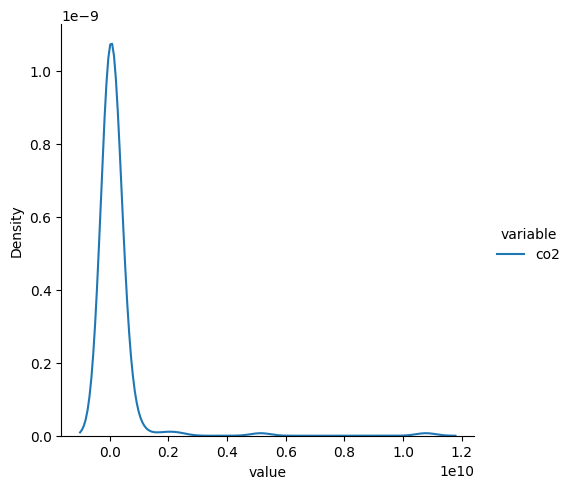

In [ ]:
#GRAFICO de DataNames1
import seaborn as sns
import matplotlib.pyplot as plt

sns.displot(pd.melt(theMapAndData[DataNames1]),
            x="value", hue="variable",kind="kde",
            log_scale=(False,False))

In [ ]:
#Para asegurar que las variables se puedan comparar y analizar adecuadamente,
#es necesario reescalar, dado que están expresadas en diferentes unidades:

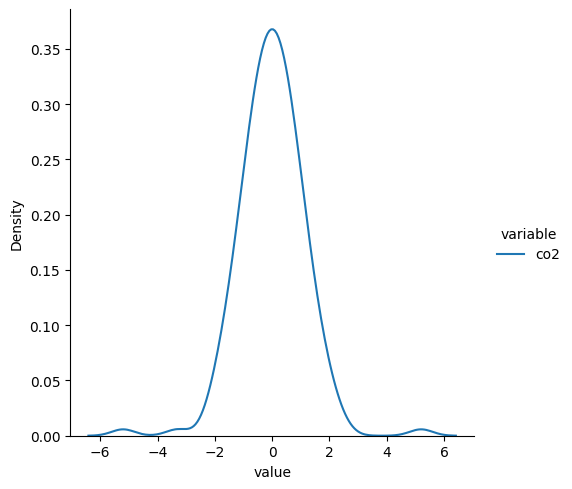

In [ ]:
from sklearn.preprocessing import QuantileTransformer
scaler = QuantileTransformer(n_quantiles=99, random_state=0,output_distribution='normal') #or 'uniform'
QtScaled_data = scaler.fit_transform(theMapAndData[DataNames1])

sns.displot(pd.melt(pd.DataFrame(QtScaled_data,columns=DataNames1)),
            x="value", hue="variable",kind="kde",
            log_scale=(False,False))

In [ ]:
theMapAndData['co2_Qt']=QtScaled_data[:,0]

In [ ]:
#Discretizing
! pip show numba mapclassify numpy

Name: numba
Version: 0.60.0
Summary: compiling Python code using LLVM
Home-page: https://numba.pydata.org
Author: 
Author-email: 
License: BSD
Location: /usr/local/lib/python3.10/dist-packages
Requires: llvmlite, numpy
Required-by: cudf-cu12, librosa, rmm-cu12, shap
---
Name: numpy
Version: 1.26.4
Summary: Fundamental package for array computing in Python
Home-page: https://numpy.org
Author: Travis E. Oliphant et al.
Author-email: 
License: Copyright (c) 2005-2023, NumPy Developers.
        All rights reserved.
        
        Redistribution and use in source and binary forms, with or without
        modification, are permitted provided that the following conditions are
        met:
        
            * Redistributions of source code must retain the above copyright
               notice, this list of conditions and the following disclaimer.
        
            * Redistributions in binary form must reproduce the above
               copyright notice, this list of conditions and the 

In [ ]:
 !pip install mapclassify

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.1/59.1 kB 3.0 MB/s eta 0:00:00


In [ ]:
import mapclassify
import numpy as np

np.random.seed(12345) # so we all get the same results!

# creamos 5 intervalos
K=5
theVar=theMapAndData.co2_Qt
# same interval width, easy interpretation
ei5 = mapclassify.EqualInterval(theVar, k=K)
# same interval width based on standard deviation, easy - but not as the previous one, poor when high skewness
msd = mapclassify.StdMean(theVar)
# interval width varies, counts per interval are close, not easy to grasp, repeated values complicate cuts
q5=mapclassify.Quantiles(theVar,k=K)

# based on similarity, good for multimodal data
mb5 = mapclassify.MaximumBreaks(theVar, k=K)
# based on similarity, good for skewed data
ht = mapclassify.HeadTailBreaks(theVar) # no K needed
# based on similarity, optimizer
fj5 = mapclassify.FisherJenks(theVar, k=K)
# based on similarity, optimizer
jc5 = mapclassify.JenksCaspall(theVar, k=K)
# based on similarity, optimizer
mp5 = mapclassify.MaxP(theVar, k=K)

In [ ]:
class5 = ei5, msd, q5, mb5,  ht, fj5, jc5, mp5
# Collect ADCM for each classifier
fits = np.array([ c.adcm for c in class5])
# Convert ADCM scores to a DataFrame
adcms = pd.DataFrame(fits)
# Add classifier names
adcms['classifier'] = [c.name for c in class5]
# Add column names to the ADCM
adcms.columns = ['ADCM', 'Classifier']

<Axes: ylabel='Classifier'>

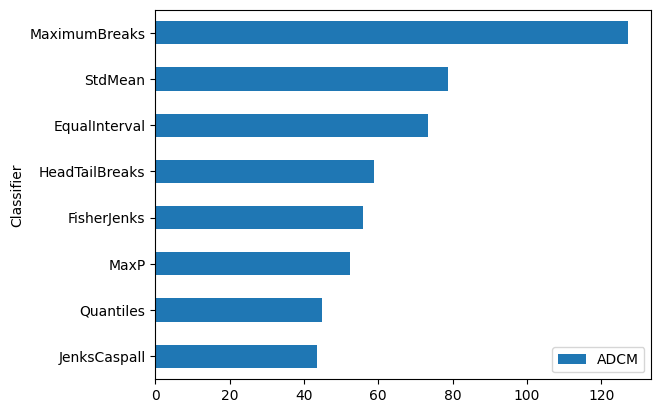

In [ ]:
adcms.sort_values('ADCM').plot.barh(x='Classifier')

In [ ]:
# nos quedamos con el tiene menor valor de ADCM, ya que es el que tiene menor disperción. Ello significa que esta creando mejores grupos

In [ ]:
theMapAndData['co2_Qt_jc5'] = jc5.yb



In [ ]:
# visualizamos
theMapAndData[['co2_Qt','co2_Qt_jc5']].head()

,co2_Qt,co2_Qt_jc5
0,-1.417436,0
1,-0.312096,1
2,0.903225,3
3,0.282063,2
4,-0.757475,1


In [ ]:
indexList=['co2_Qt_jc5'] # add more?
aggregator={'co2_Qt': ['mean']}

pd.concat([theMapAndData[['co2_Qt',col]].groupby(col,as_index=False).agg(aggregator) for col in indexList],axis=1)

,co2_Qt_jc5,co2_Qt
,,mean
0,0,-1.663108
1,1,-0.623926
2,2,0.014829
3,3,0.640064
4,4,1.630121


In [ ]:
# renaming
newLabelsForLevels={0:"0_Great", 1:"1_Good", 2:"2_Middle", 3:"3_Bad", 4:"4_Poor"}

theMapAndData['co2_Qt_jc5_cat']=theMapAndData.loc[:,'co2_Qt_jc5'].replace(newLabelsForLevels)

# we have
theMapAndData[['co2_Qt','co2_Qt_jc5','co2_Qt_jc5_cat']].head(20)

,co2_Qt,co2_Qt_jc5,co2_Qt_jc5_cat
0,-1.417436,0,0_Great
1,-0.312096,1,1_Good
2,0.903225,3,3_Bad
3,0.282063,2,2_Middle
4,-0.757475,1,1_Good
5,-0.514615,1,1_Good
6,0.106163,2,2_Middle
7,-1.740792,0,0_Great
8,0.956291,3,3_Bad
9,1.417745,4,4_Poor


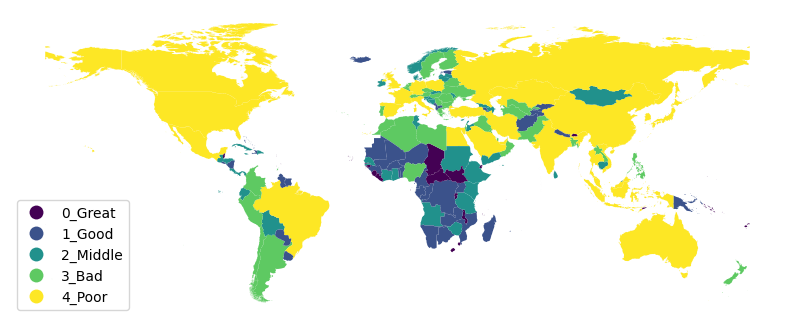

In [ ]:
import matplotlib.pyplot as plt

f, ax = plt.subplots(1, figsize=(10, 10))
theMapAndData.plot(column='co2_Qt_jc5_cat', # variable to plot
                   cmap='viridis', # set of colors
                   categorical=True, # can be interpreted as category
                   edgecolor='white', # border color
                   linewidth=0., # width of border
                   alpha=1, # level of transparency (0 is invisible)
                   legend=True, # need a legend?
                   # location of legend: 'best', 'upper right', 'upper left', 'lower left',
                   # 'lower right', 'right', 'center left', 'center right',
                   # 'lower center', 'upper center', 'center'
                   legend_kwds={'loc':"lower left"},
        ax=ax
       )

ax.set_axis_off()

In [ ]:
#Repetimos el proceso para hallar el papa de ForestRev_gdp
DataNames2=['ForestRev_gdp']

In [ ]:
pd.melt(theMapAndData[DataNames2])

,variable,value
0,ForestRev_gdp,0.00
1,ForestRev_gdp,0.20
2,ForestRev_gdp,0.10
3,ForestRev_gdp,0.02
4,ForestRev_gdp,0.18
...,...,...
166,ForestRev_gdp,4.45
167,ForestRev_gdp,1.61
168,ForestRev_gdp,2.65
169,ForestRev_gdp,0.39


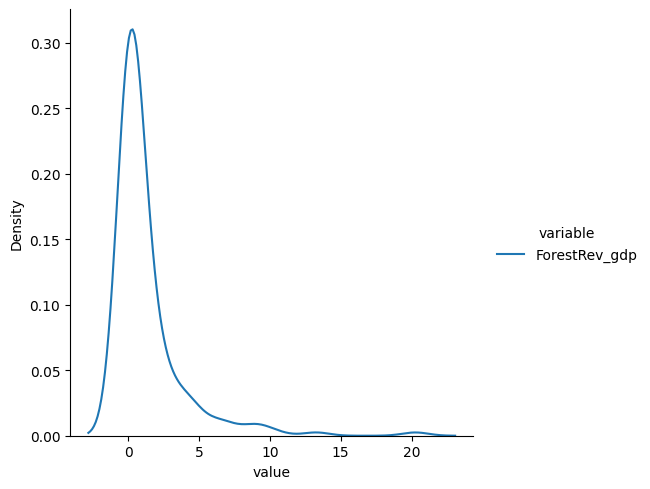

In [ ]:
#GRAFICO de DataNames2
import seaborn as sns
import matplotlib.pyplot as plt

sns.displot(pd.melt(theMapAndData[DataNames2]),
            x="value", hue="variable",kind="kde",
            log_scale=(False,False))

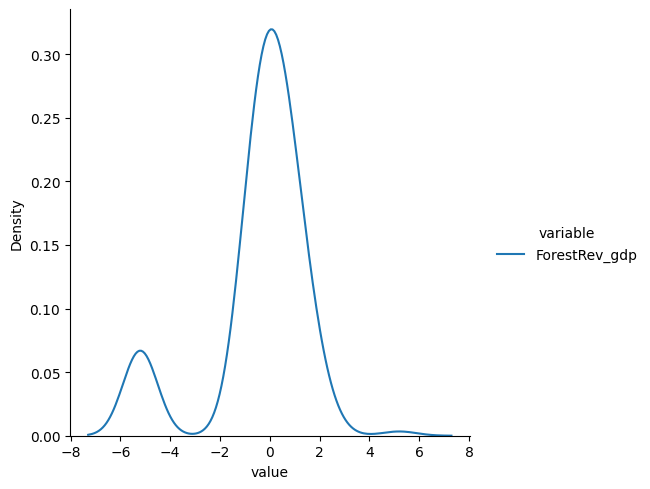

In [ ]:
from sklearn.preprocessing import QuantileTransformer
scaler = QuantileTransformer(n_quantiles=99, random_state=0,output_distribution='normal') #or 'uniform'
QtScaled_data = scaler.fit_transform(theMapAndData[DataNames2])

sns.displot(pd.melt(pd.DataFrame(QtScaled_data,columns=DataNames2)),
            x="value", hue="variable",kind="kde",
            log_scale=(False,False))

In [ ]:
theMapAndData['ForestRev_gdp_Qt']=QtScaled_data[:,0]

In [ ]:
import mapclassify
import numpy as np

np.random.seed(12345) # so we all get the same results!

# creamos 5 intervalos
K=5
theVar=theMapAndData.ForestRev_gdp_Qt
# same interval width, easy interpretation
ei5 = mapclassify.EqualInterval(theVar, k=K)
# same interval width based on standard deviation, easy - but not as the previous one, poor when high skewness
msd = mapclassify.StdMean(theVar)
# interval width varies, counts per interval are close, not easy to grasp, repeated values complicate cuts
q5=mapclassify.Quantiles(theVar,k=K)

# based on similarity, good for multimodal data
mb5 = mapclassify.MaximumBreaks(theVar, k=K)
# based on similarity, good for skewed data
ht = mapclassify.HeadTailBreaks(theVar) # no K needed
# based on similarity, optimizer
fj5 = mapclassify.FisherJenks(theVar, k=K)
# based on similarity, optimizer
jc5 = mapclassify.JenksCaspall(theVar, k=K)
# based on similarity, optimizer
mp5 = mapclassify.MaxP(theVar, k=K)

In [ ]:
class5 = ei5, msd, q5, mb5,  ht, fj5, jc5, mp5
# Collect ADCM for each classifier
fits = np.array([ c.adcm for c in class5])
# Convert ADCM scores to a DataFrame
adcms = pd.DataFrame(fits)
# Add classifier names
adcms['classifier'] = [c.name for c in class5]
# Add column names to the ADCM
adcms.columns = ['ADCM', 'Classifier']

<Axes: ylabel='Classifier'>

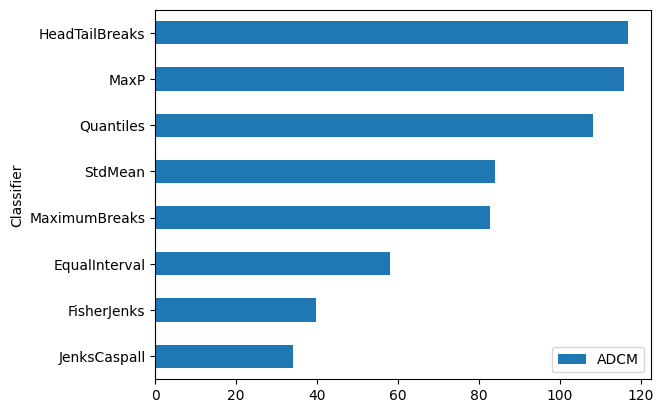

In [ ]:
adcms.sort_values('ADCM').plot.barh(x='Classifier')

In [ ]:
theMapAndData['ForestRev_gpd_Qt_jc5'] = jc5.yb



In [ ]:
# visualizamos
theMapAndData[['co2_Qt','co2_Qt_jc5']].head()

,co2_Qt,co2_Qt_jc5
0,-5.199338,0
1,-0.076809,1
2,-0.352465,3
3,-0.827130,2
4,-0.106447,1


In [ ]:
# visualizamos

theMapAndData[['ForestRev_gdp_Qt','ForestRev_gpd_Qt_jc5']].head()

,ForestRev_gdp_Qt,ForestRev_gpd_Qt_jc5
0,-5.199338,0
1,-0.076809,2
2,-0.352465,2
3,-0.827130,1
4,-0.106447,2


In [ ]:
indexList=['ForestRev_gpd_Qt_jc5'] # add more?
aggregator={'ForestRev_gdp_Qt': ['mean']}

pd.concat([theMapAndData[['ForestRev_gdp_Qt',col]].groupby(col,as_index=False).agg(aggregator) for col in indexList],axis=1)

,ForestRev_gpd_Qt_jc5,ForestRev_gdp_Qt
,,mean
0,0,-5.199338
1,1,-0.762467
2,2,-0.050787
3,3,0.635412
4,4,1.657795


In [ ]:
# renaming
newLabelsForLevels={0:"0_Great", 1:"1_Good", 2:"2_Middle", 3:"3_Bad", 4:"4_Poor"}

theMapAndData[' ForestRev_gdp_Qt_jc5_cat ']=theMapAndData.loc[:, 'ForestRev_gpd_Qt_jc5' ].replace(newLabelsForLevels)

# we have
theMapAndData[['ForestRev_gdp_Qt','ForestRev_gpd_Qt_jc5','ForestRev_gdp_Qt_jc5_cat']].head(20)

,ForestRev_gdp_Qt,ForestRev_gpd_Qt_jc5,ForestRev_gdp_Qt_jc5_cat
0,-5.199338,0,0_Great
1,-0.076809,2,2_Middle
2,-0.352465,2,2_Middle
3,-0.827130,1,1_Good
4,-0.106447,2,2_Middle
5,0.088585,2,2_Middle
6,0.206072,2,2_Middle
7,0.069685,2,2_Middle
8,-0.421391,1,1_Good
9,-0.271880,2,2_Middle


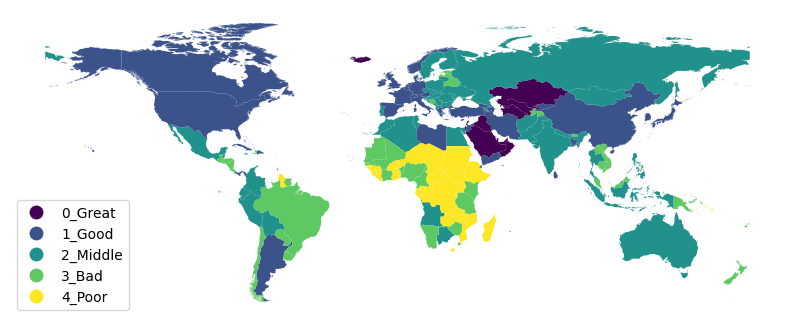

In [ ]:
import matplotlib.pyplot as plt

f, ax = plt.subplots(1, figsize=(10, 10))
theMapAndData.plot(column='ForestRev_gdp_Qt_jc5_cat', # variable to plot
                   cmap='viridis', # set of colors
                   categorical=True, # can be interpreted as category
                   edgecolor='white', # border color
                   linewidth=0., # width of border
                   alpha=1, # level of transparency (0 is invisible)
                   legend=True, # need a legend?
                   # location of legend: 'best', 'upper right', 'upper left', 'lower left',
                   # 'lower right', 'right', 'center left', 'center right',
                   # 'lower center', 'upper center', 'center'
                   legend_kwds={'loc':"lower left"},
        ax=ax
       )

ax.set_axis_off()

In [ ]:
import pandas as pd

GHGLink="https://github.com/Melisapadilla/introgeodf/raw/refs/heads/main/DATA2NEW-%20Hoja1.csv"

GHG=pd.read_csv(GHGLink)

GHG.head()

,COUNTRY_NAME,COUNTRY_CODE,GHG_EMISSIONS_IN_2022
0,Aruba,ABW,"0,4967"
1,Africa Eastern and Southern,AFE,"1519,0806"
2,Afghanistan,AFG,"29,0264"
3,Africa Western and Central,AFW,"956,2243"
4,Angola,AGO,"66,4801"


In [ ]:

# Convert it to string type before using .str.replace
GHG['GHG_EMISSIONS_IN_2022'] = GHG['GHG_EMISSIONS_IN_2022'].astype(str).str.replace(',', '.', regex=True)

# Verifica el resultado
print(GHG[['COUNTRY_NAME', 'GHG_EMISSIONS_IN_2022']].head())

                  COUNTRY_NAME GHG_EMISSIONS_IN_2022
0                        Aruba                0.4967
1  Africa Eastern and Southern             1519.0806
2                  Afghanistan               29.0264
3   Africa Western and Central              956.2243
4                       Angola               66.4801


In [ ]:
# convertir la columna a float
GHG['GHG_EMISSIONS_IN_2022'] = pd.to_numeric(GHG['GHG_EMISSIONS_IN_2022'], errors='coerce')
GHG

,COUNTRY_NAME,COUNTRY_CODE,GHG_EMISSIONS_IN_2022
0,Aruba,ABW,0.4967
1,Africa Eastern and Southern,AFE,1519.0806
2,Afghanistan,AFG,29.0264
3,Africa Western and Central,AFW,956.2243
4,Angola,AGO,66.4801
...,...,...,...
261,Kosovo,XKX,NaN
262,"Yemen, Rep.",YEM,38.0060
263,South Africa,ZAF,533.8207
264,Zambia,ZMB,30.3001


In [ ]:
GHG.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 266 entries, 0 to 265
Data columns (total 3 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   COUNTRY_NAME           266 non-null    object 
 1   COUNTRY_CODE           266 non-null    object 
 2   GHG_EMISSIONS_IN_2022  251 non-null    float64
dtypes: float64(1), object(2)
memory usage: 6.4+ KB


In [ ]:
# pasamos a mayusculas
GHG['COUNTRY_NAME']=GHG.COUNTRY_NAME.str.upper()

In [ ]:
# Change 'GHG.Country' to 'GHG["Country Name"] to match actual column name:
onlyGHG=set(GHG.COUNTRY_NAME)- set(countries.COUNTRY)
onlyMap=set(countries.COUNTRY)- set(GHG.COUNTRY_NAME)

In [ ]:
from thefuzz import process

onlyGHG = [str(item) for item in onlyGHG]

# Now proceed with the original code
[(COUNTRY_NAME, process.extractOne(COUNTRY_NAME, onlyMap)) for COUNTRY_NAME in sorted(onlyGHG)]

[('AFRICA EASTERN AND SOUTHERN',
  ('FRENCH SOUTHERN & ANTARCTIC LANDS (FRANCE)', 86)),
 ('AFRICA WESTERN AND CENTRAL',
  ('SOUTH GEORGIA AND THE SOUTH SANDWICH IS (UK)', 86)),
 ('AMERICAN SAMOA', ('AMERICAN SAMOA (US)', 95)),
 ('ARAB WORLD', ('NORTHERN MARIANA ISLANDS (US)', 51)),
 ('ARUBA', ('ARUBA (NETHERLANDS)', 90)),
 ('BAHAMAS, THE', ('BAHAMAS', 90)),
 ('BERMUDA', ('BERMUDA (UK)', 90)),
 ('BRITISH VIRGIN ISLANDS', ('BRITISH VIRGIN ISLANDS(UK)', 95)),
 ('BRUNEI DARUSSALAM', ('BRUNEI', 90)),
 ('CABO VERDE', ('CAPE VERDE', 80)),
 ('CARIBBEAN SMALL STATES', ('AMERICAN SAMOA (US)', 55)),
 ('CAYMAN ISLANDS', ('CAYMAN ISLANDS (UK)', 95)),
 ('CENTRAL EUROPE AND THE BALTICS', ('ANTARCTICA', 51)),
 ('CHANNEL ISLANDS', ('COCOS (KEELING) ISLANDS (AUSTRALIA)', 86)),
 ('CONGO, DEM. REP.', ('CONGO', 90)),
 ('CONGO, REP.', ('CONGO', 90)),
 ("COTE D'IVOIRE", ('IVORY COAST', 63)),
 ('CURACAO', ('CURACAO (NETHERLANDS)', 90)),
 ('CZECHIA', ('CZECH REPUBLIC', 75)),
 ('EARLY-DEMOGRAPHIC DIVIDEND', ('V

In [ ]:
[(country, process.extractOne(country,onlyMap)) for country in sorted(onlyGHG)
 if process.extractOne(country,onlyMap)[1]>=90]

[('AMERICAN SAMOA', ('AMERICAN SAMOA (US)', 95)),
 ('ARUBA', ('ARUBA (NETHERLANDS)', 90)),
 ('BAHAMAS, THE', ('BAHAMAS', 90)),
 ('BERMUDA', ('BERMUDA (UK)', 90)),
 ('BRITISH VIRGIN ISLANDS', ('BRITISH VIRGIN ISLANDS(UK)', 95)),
 ('BRUNEI DARUSSALAM', ('BRUNEI', 90)),
 ('CAYMAN ISLANDS', ('CAYMAN ISLANDS (UK)', 95)),
 ('CONGO, DEM. REP.', ('CONGO', 90)),
 ('CONGO, REP.', ('CONGO', 90)),
 ('CURACAO', ('CURACAO (NETHERLANDS)', 90)),
 ('EGYPT, ARAB REP.', ('EGYPT', 90)),
 ('FAROE ISLANDS', ('FAROE ISLANDS (DENMARK)', 90)),
 ('FRENCH POLYNESIA', ('FRENCH POLYNESIA (FRANCE)', 90)),
 ('GAMBIA, THE', ('GAMBIA', 90)),
 ('GIBRALTAR', ('GIBRALTAR (UK)', 95)),
 ('GREENLAND', ('GREENLAND (DENMARK)', 90)),
 ('GUAM', ('GUAM (US)', 90)),
 ('ISLE OF MAN', ('ISLE OF MAN (UK)', 95)),
 ('NEW CALEDONIA', ('NEW CALEDONIA (FRANCE)', 90)),
 ('NORTH MACEDONIA', ('MACEDONIA', 90)),
 ('NORTHERN MARIANA ISLANDS', ('NORTHERN MARIANA ISLANDS (US)', 95)),
 ('PALAU', ('PALAU (US)', 90)),
 ('PUERTO RICO', ('PUERTO RIC

In [ ]:
# then:
try1={country: process.extractOne(country,onlyMap)[0] for country in sorted(onlyGHG)
 if process.extractOne(country,onlyMap)[1]>=90}
try1

{'AMERICAN SAMOA': 'AMERICAN SAMOA (US)',
 'ARUBA': 'ARUBA (NETHERLANDS)',
 'BAHAMAS, THE': 'BAHAMAS',
 'BERMUDA': 'BERMUDA (UK)',
 'BRITISH VIRGIN ISLANDS': 'BRITISH VIRGIN ISLANDS(UK)',
 'BRUNEI DARUSSALAM': 'BRUNEI',
 'CAYMAN ISLANDS': 'CAYMAN ISLANDS (UK)',
 'CONGO, DEM. REP.': 'CONGO',
 'CONGO, REP.': 'CONGO',
 'CURACAO': 'CURACAO (NETHERLANDS)',
 'EGYPT, ARAB REP.': 'EGYPT',
 'FAROE ISLANDS': 'FAROE ISLANDS (DENMARK)',
 'FRENCH POLYNESIA': 'FRENCH POLYNESIA (FRANCE)',
 'GAMBIA, THE': 'GAMBIA',
 'GIBRALTAR': 'GIBRALTAR (UK)',
 'GREENLAND': 'GREENLAND (DENMARK)',
 'GUAM': 'GUAM (US)',
 'ISLE OF MAN': 'ISLE OF MAN (UK)',
 'NEW CALEDONIA': 'NEW CALEDONIA (FRANCE)',
 'NORTH MACEDONIA': 'MACEDONIA',
 'NORTHERN MARIANA ISLANDS': 'NORTHERN MARIANA ISLANDS (US)',
 'PALAU': 'PALAU (US)',
 'PUERTO RICO': 'PUERTO RICO (US)',
 'RUSSIAN FEDERATION': 'RUSSIA',
 'SAMOA': 'AMERICAN SAMOA (US)',
 'SYRIAN ARAB REPUBLIC': 'SYRIA',
 'TURKS AND CAICOS ISLANDS': 'TURKS AND CAICOS ISLANDS (UK)',
 'VENEZ

In [ ]:
DataNames=['GHG_EMISSIONS_IN_2022']


In [ ]:
pd.melt(theMapAndData[DataNames])

,variable,value
0,GHG_EMISSIONS_IN_2022,NaN
1,GHG_EMISSIONS_IN_2022,NaN
2,GHG_EMISSIONS_IN_2022,NaN
3,GHG_EMISSIONS_IN_2022,NaN
4,GHG_EMISSIONS_IN_2022,NaN
...,...,...
191,GHG_EMISSIONS_IN_2022,NaN
192,GHG_EMISSIONS_IN_2022,NaN
193,GHG_EMISSIONS_IN_2022,NaN
194,GHG_EMISSIONS_IN_2022,NaN


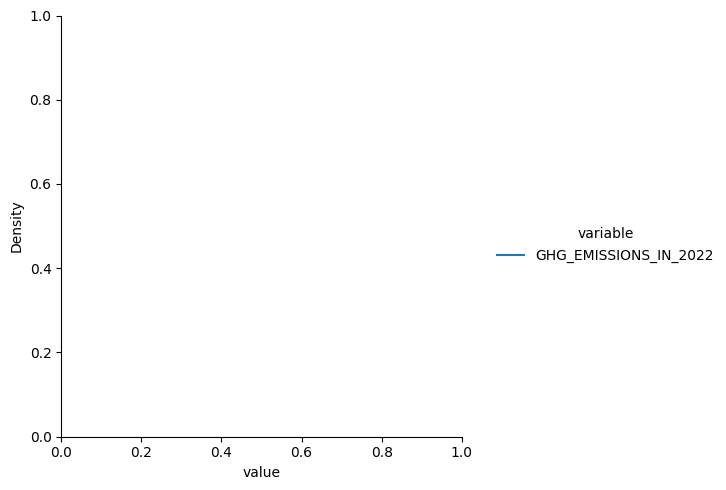

In [ ]:
# Convert 'GHG_EMISSIONS_IN_2022' to numeric
theMapAndData['GHG_EMISSIONS_IN_2022'] = pd.to_numeric(theMapAndData['GHG_EMISSIONS_IN_2022'], errors='coerce')

import seaborn as sns
import matplotlib.pyplot as plt

sns.displot(pd.melt(theMapAndData[DataNames]),
            x="value", hue="variable", kind="kde",
            log_scale=(False, False))

/usr/local/lib/python3.10/dist-packages/numpy/lib/nanfunctions.py:1563: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a,


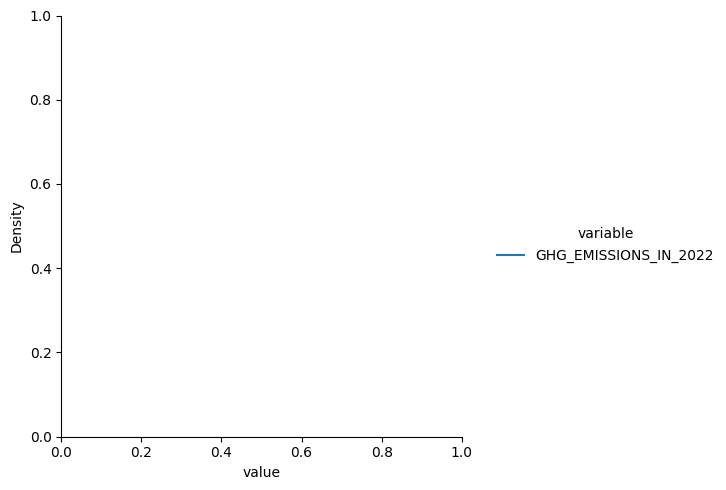

In [ ]:
from sklearn.preprocessing import QuantileTransformer
scaler = QuantileTransformer(n_quantiles=99, random_state=0,output_distribution='normal') #or 'uniform'
QtScaled_data = scaler.fit_transform(theMapAndData[DataNames])

sns.displot(pd.melt(pd.DataFrame(QtScaled_data,columns=DataNames)),
            x="value", hue="variable",kind="kde",
            log_scale=(False,False))